<a href="https://colab.research.google.com/github/23btrec036/DAN-S-FMML_PROJECT-REPORT/blob/main/Vehicle_and_Human_detect_usin_SDA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install ultralytics
import os
from ultralytics import YOLO
from IPython.display import display, Image
from IPython import display
import torch
import cv2
import matplotlib.pyplot as plt
import numpy as np

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 16.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 57.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 22.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 33.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 57.8 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling 

In [ ]:
import yaml
with open('/kaggle/input/traffic-detection-project/data.yaml','r') as f:
    data=yaml.safe_load(f)
    print(data['names'])

FileNotFoundError: [Errno 2] No such file or directory: '/kaggle/input/traffic-detection-project/data.yaml'

In [ ]:
class_names=['bicycle', 'bus', 'car', 'motorbike', 'person']

In [ ]:
import random
import cv2
import os
import matplotlib.pyplot as plt

image_dir = '/kaggle/input/traffic-detection-project/train/images'
label_files = '/kaggle/input/traffic-detection-project/train/labels'

class_names = ['bicycle', 'bus', 'car', 'motorbike', 'person']

image_files = os.listdir(image_dir)
random_images = random.sample(image_files, 40)

fig, axs = plt.subplots(8, 5, figsize=(22, 22))
axs = axs.flatten()

for i, image_file in enumerate(random_images):
    image_path = os.path.join(image_dir, image_file)
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    label_file = os.path.splitext(image_file)[0] + ".txt"
    label_path = os.path.join(label_files, label_file)

    if os.path.exists(label_path):
        with open(label_path, "r") as f:
            labels = f.read().strip().split("\n")

        for label in labels:
            if len(label.split()) != 5:
                continue
            class_id, x_center, y_center, width, height = map(float, label.split())
            x_min = int((x_center - width / 2) * image.shape[1])
            y_min = int((y_center - height / 2) * image.shape[0])
            x_max = int((x_center + width / 2) * image.shape[1])
            y_max = int((y_center + height / 2) * image.shape[0])

            cv2.rectangle(image, (x_min, y_min), (x_max, y_max), (0, 255, 0), 3)

            text_scale = max(0.5, min(image.shape[1], image.shape[0]) / 700)
            text_thickness = max(1, int(text_scale * 2))
            classe = class_names[int(class_id)]
            cv2.putText(
                image,
                classe,
                (x_min, max(y_min - 10, 0)),
                cv2.FONT_HERSHEY_SIMPLEX,
                text_scale,
                (0, 0, 255),
                text_thickness,
                cv2.LINE_AA,
            )

    axs[i].imshow(image)
    axs[i].axis('off')

plt.subplots_adjust(wspace=0.2, hspace=0.2)
plt.show()


FileNotFoundError: [Errno 2] No such file or directory: '/kaggle/input/traffic-detection-project/train/images'

In [ ]:
model=YOLO('yolov10s.pt')

100%|██████████| 15.9M/15.9M [00:00<00:00, 130MB/s] 


In [ ]:
model.train(data="/kaggle/input/traffic-detection-project/data.yaml", epochs=8, imgsz = 640,batch=16)

Ultralytics 8.3.55 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov10s.pt, data=/kaggle/input/traffic-detection-project/data.yaml, epochs=8, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, sho

100%|██████████| 755k/755k [00:00<00:00, 16.7MB/s]


Overriding model.yaml nc=80 with nc=5

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]             
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  5                  -1  1     36096  ultralytics.nn.modules.block.SCDown          [128, 256, 3, 2]              
  6                  -1  2    788480  ultralytics.nn.modules.block.C2f             [256, 256, 2, True]           
  7                  -1  1    137728  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 69.9MB/s]


AMP: checks passed ✅


train: Scanning /kaggle/input/traffic-detection-project/train/labels... 5805 images, 93 backgrounds, 0 corrupt: 100%|██████████| 5805/5805 [00:27<00:00, 213.57it/s]


train: WARNING ⚠️ Cache directory /kaggle/input/traffic-detection-project/train is not writeable, cache not saved.
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:13: UserWarning: A new version of Albumentations is available: 1.4.24 (you have 1.4.15). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
val: Scanning /kaggle/input/traffic-detection-project/valid/labels... 549 images, 8 backgrounds, 0 corrupt: 100%|██████████| 549/549 [00:02<00:00, 218.14it/s]

val: WARNING ⚠️ Cache directory /kaggle/input/traffic-detection-project/valid is not writeable, cache not saved.


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001111, momentum=0.9) with parameter groups 99 weight(decay=0.0), 112 weight(decay=0.0005), 111 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 8 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/8      5.95G      2.826      2.957      2.226        165        640: 100%|██████████| 363/363 [02:13<00:00,  2.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:07<00:00,  2.50it/s]

                   all        549       6270      0.678       0.66      0.697      0.442



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        2/8      5.89G      2.716      1.936      2.193        185        640: 100%|██████████| 363/363 [02:09<00:00,  2.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.11it/s]

                   all        549       6270      0.726      0.656      0.713      0.463



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        3/8      5.54G       2.66        1.8      2.175        200        640: 100%|██████████| 363/363 [02:08<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.06it/s]

                   all        549       6270      0.741      0.671      0.752      0.497



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        4/8      5.86G      2.572      1.662      2.127        211        640: 100%|██████████| 363/363 [02:08<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.11it/s]

                   all        549       6270      0.751      0.754      0.802      0.539



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        5/8      5.77G       2.48       1.54      2.089        245        640: 100%|██████████| 363/363 [02:08<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.13it/s]

                   all        549       6270      0.797      0.742      0.809      0.545



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        6/8      6.08G      2.373      1.419      2.037        221        640: 100%|██████████| 363/363 [02:07<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.17it/s]

                   all        549       6270      0.828      0.764      0.847       0.59



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        7/8      5.72G      2.292      1.333       2.01        269        640: 100%|██████████| 363/363 [02:08<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.10it/s]

                   all        549       6270      0.831      0.796       0.87      0.614



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        8/8      6.01G      2.219      1.253      1.977        183        640: 100%|██████████| 363/363 [02:08<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.13it/s]

                   all        549       6270      0.861       0.81      0.887      0.646



8 epochs completed in 0.312 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 16.5MB
Optimizer stripped from runs/detect/train/weights/best.pt, 16.5MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.55 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
YOLOv10s summary (fused): 293 layers, 8,038,830 parameters, 0 gradients, 24.5 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:07<00:00,  2.29it/s]


                   all        549       6270      0.861       0.81      0.887      0.646
               bicycle        189        250      0.864      0.868      0.916      0.712
                   bus         81        108       0.89      0.826      0.917      0.798
                   car        520       3842      0.886      0.913      0.958      0.734
             motorbike        331       1238      0.874      0.785      0.877      0.547
                person        196        832      0.791      0.657      0.769      0.439
Speed: 0.2ms preprocess, 6.2ms inference, 0.0ms loss, 0.5ms postprocess per image
Results saved to runs/detect/train


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7845b516b580>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

In [ ]:
metrics = model.val(split='val')

print(f"Mean Average Precision @.5:.95 : {metrics.box.map}")
print(f"Mean Average Precision @ .50   : {metrics.box.map50}")
print(f"Mean Average Precision @ .70   : {metrics.box.map75}")
print("recall : ",metrics.box.r)
print(metrics.box.f1)
print(metrics.box.maps)

Ultralytics 8.3.55 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
YOLOv10s summary (fused): 293 layers, 8,038,830 parameters, 0 gradients, 24.5 GFLOPs


val: Scanning /kaggle/input/traffic-detection-project/valid/labels... 549 images, 8 backgrounds, 0 corrupt: 100%|██████████| 549/549 [00:01<00:00, 487.68it/s]

val: WARNING ⚠️ Cache directory /kaggle/input/traffic-detection-project/valid is not writeable, cache not saved.



/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:10<00:00,  3.31it/s]


                   all        549       6270       0.86       0.81      0.887      0.645
               bicycle        189        250      0.861      0.869      0.915       0.71
                   bus         81        108       0.89      0.826      0.917      0.796
                   car        520       3842      0.885      0.913      0.957      0.734
             motorbike        331       1238      0.874      0.786      0.877      0.547
                person        196        832      0.791      0.659      0.769      0.438
Speed: 0.2ms preprocess, 10.8ms inference, 0.0ms loss, 0.4ms postprocess per image
Results saved to runs/detect/train2
Mean Average Precision @.5:.95 : 0.6451786632513985
Mean Average Precision @ .50   : 0.8870128365842046
Mean Average Precision @ .70   : 0.7284257430129709
recall :  [    0.86879     0.82569     0.91281     0.78577     0.65865]
[    0.86499     0.85673     0.89852     0.82762     0.71896]
[     0.7097      0.7963     0.73446     0.54723     0.43

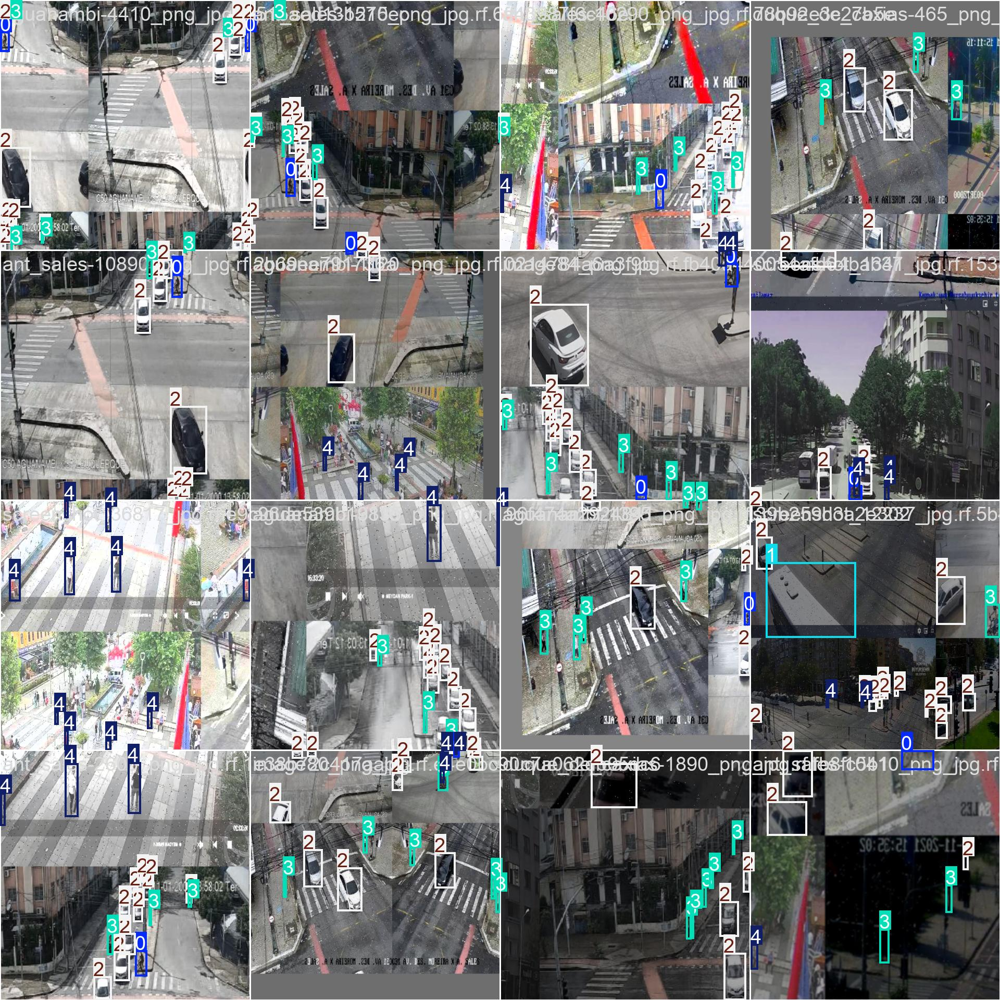

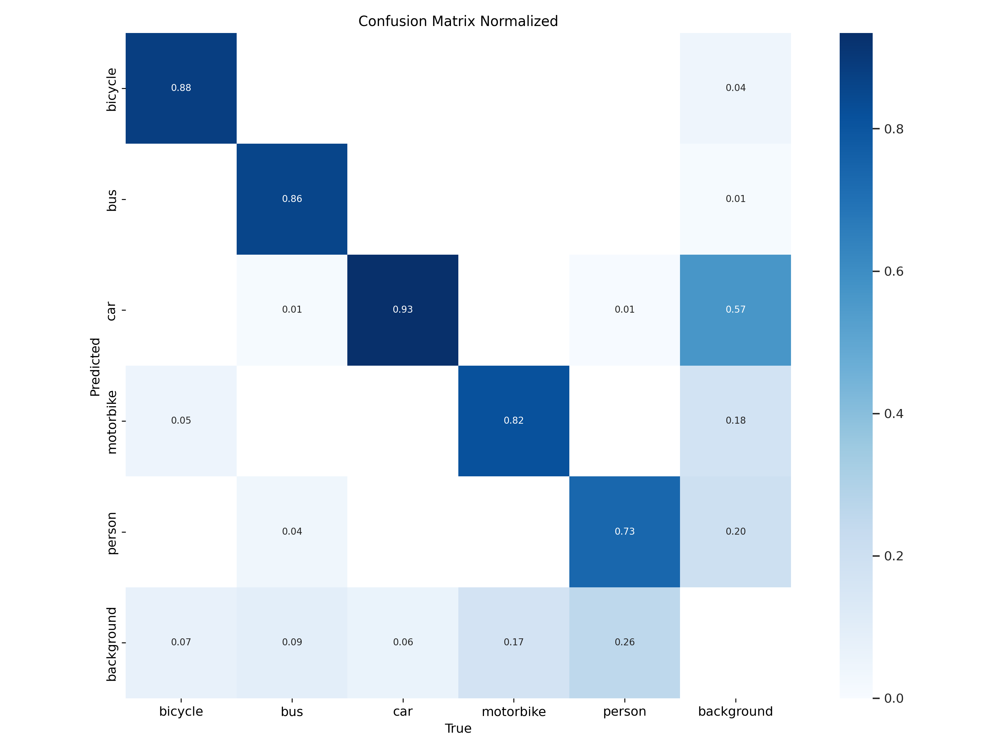

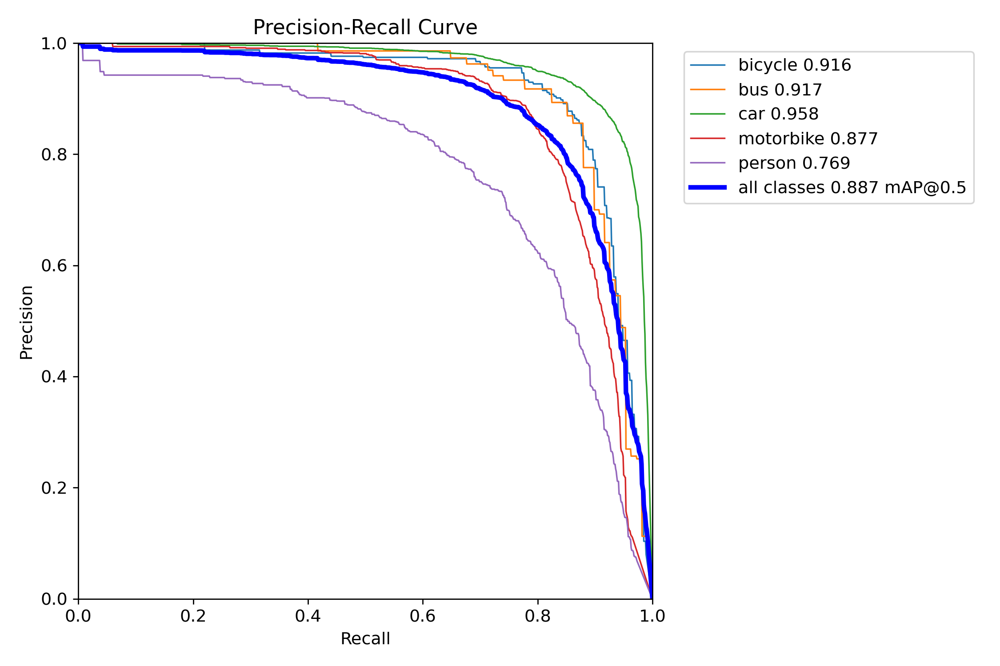

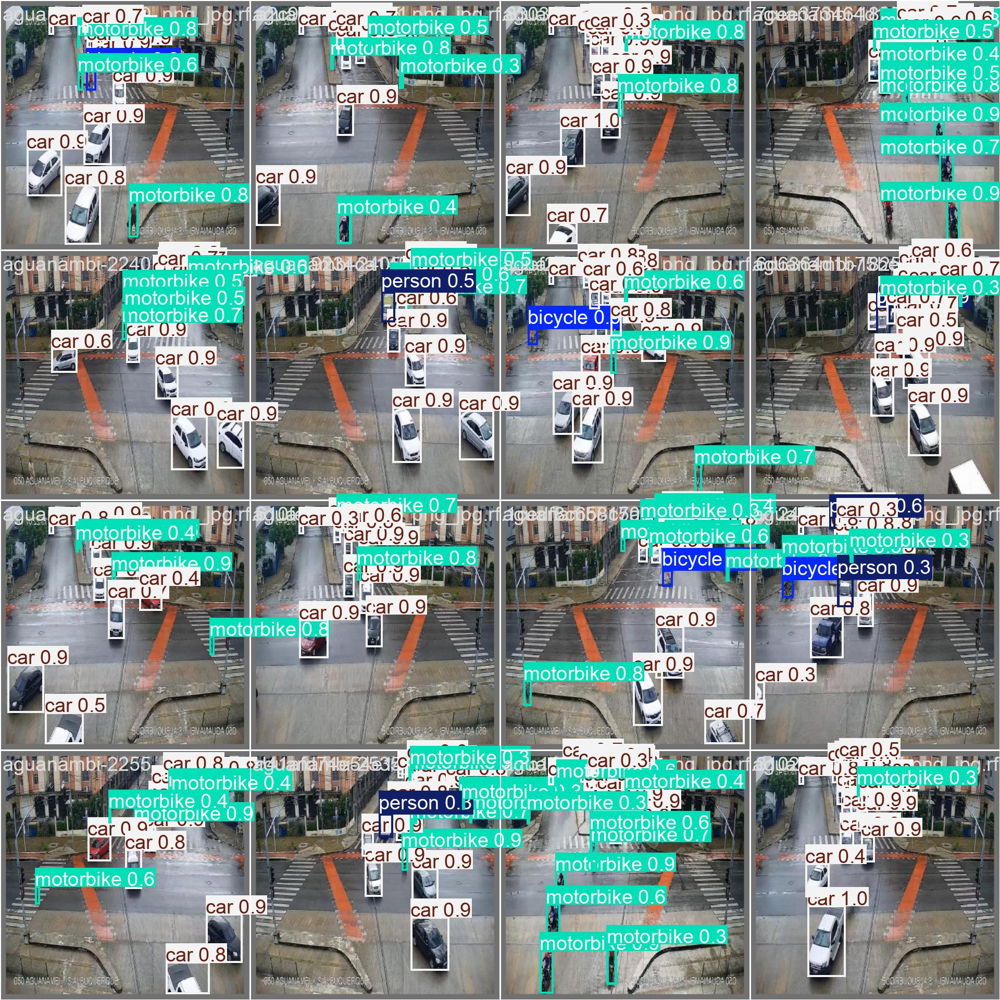

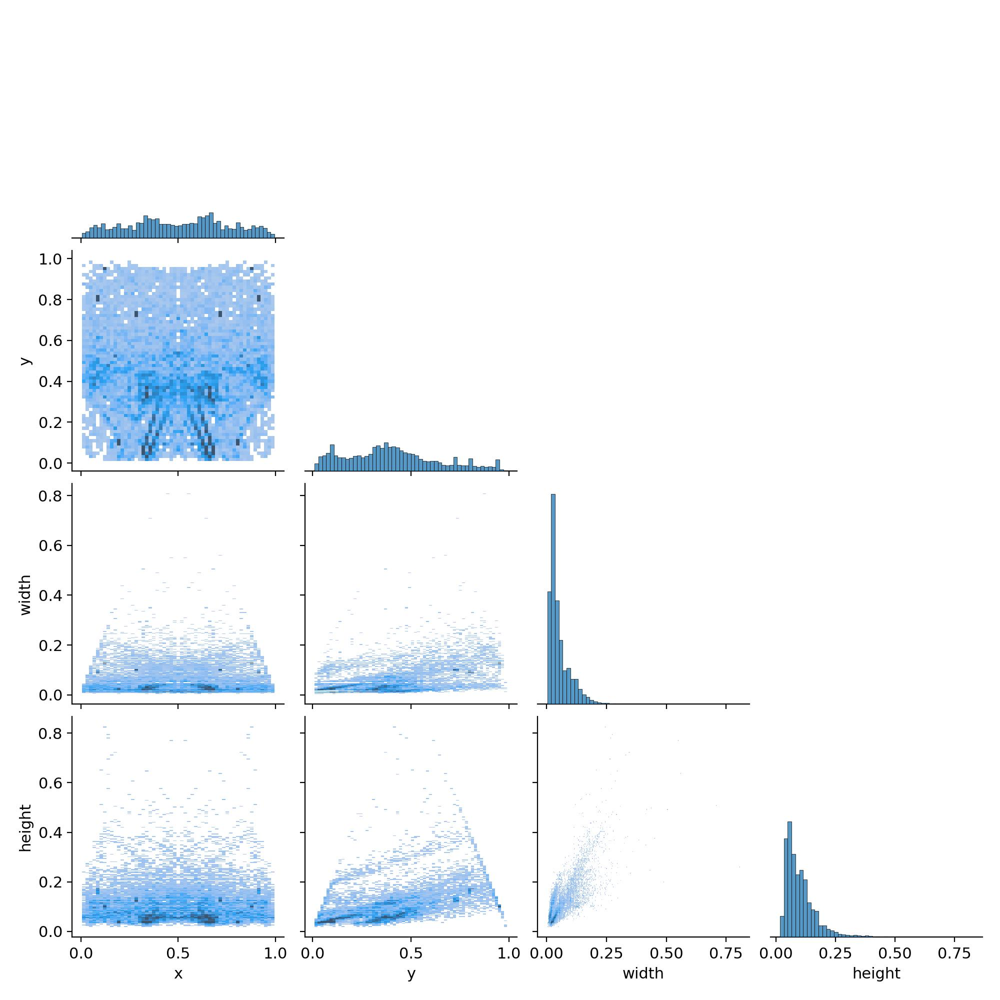

...

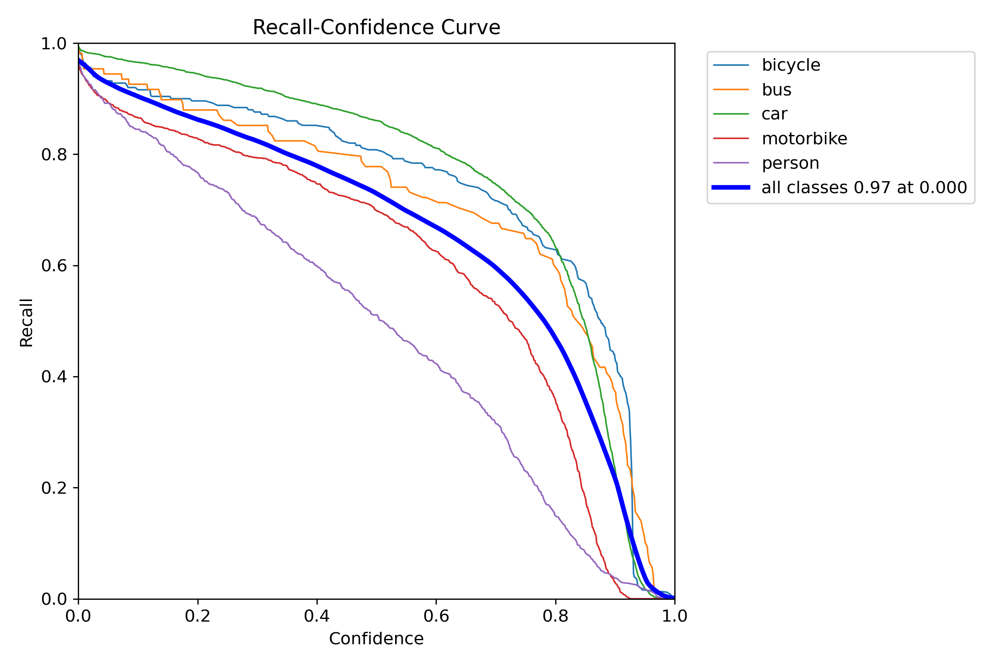

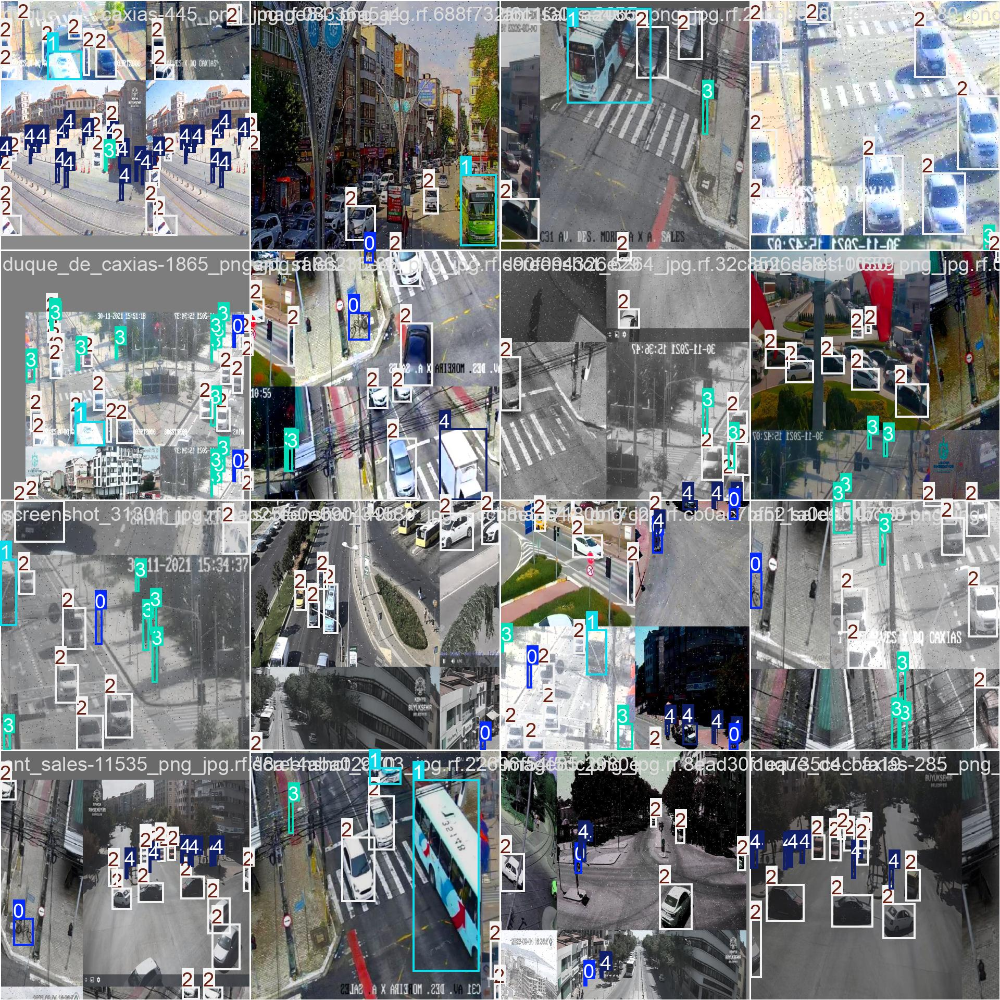

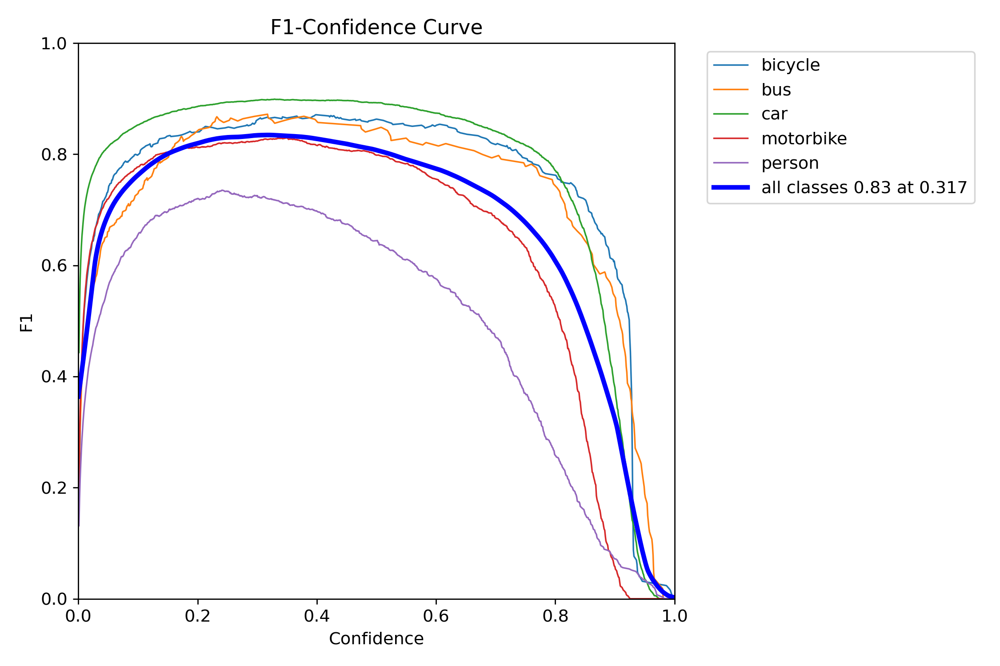

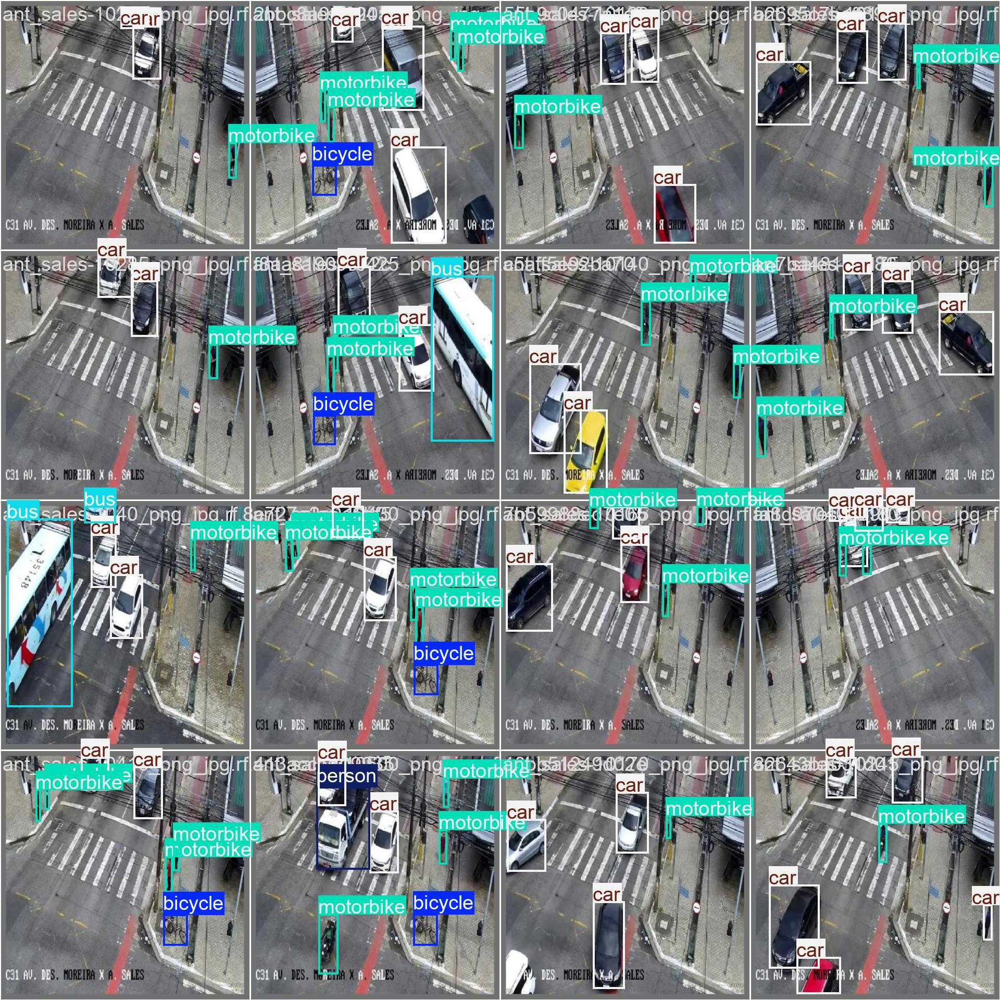

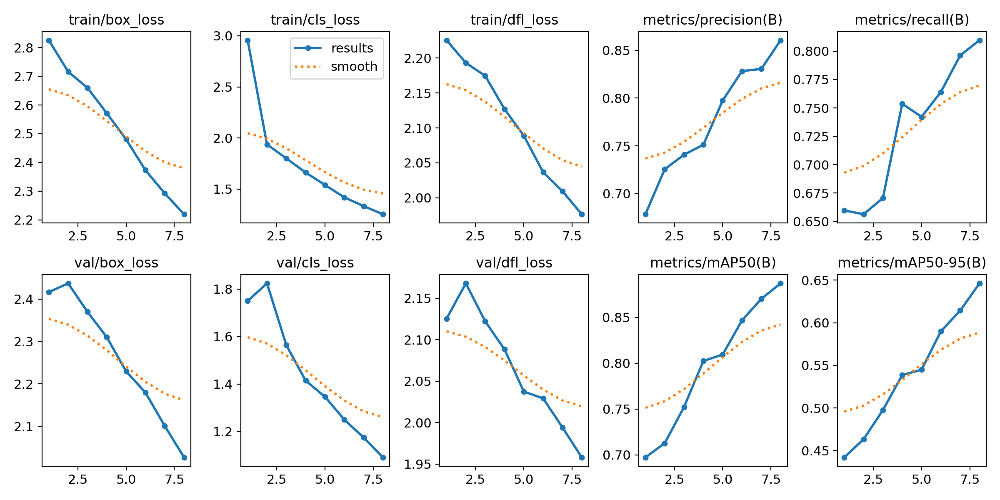

In [ ]:
from IPython.display import Image,display
path='/kaggle/working/runs/detect/train'
image=[f for f in os.listdir(path) if f.endswith(('.jpg','.png','.jpeg'))]
for i in image:
    display(Image(filename=path+'/'+i))


image 1/1 /kaggle/input/traffic-detection-project/test/images/screenshot_3576_jpg.rf.677ee49aacd9da749aeba086b5506f71.jpg: 640x640 1 bicycle, 28 cars, 4 persons, 17.0ms
Speed: 1.9ms preprocess, 17.0ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)


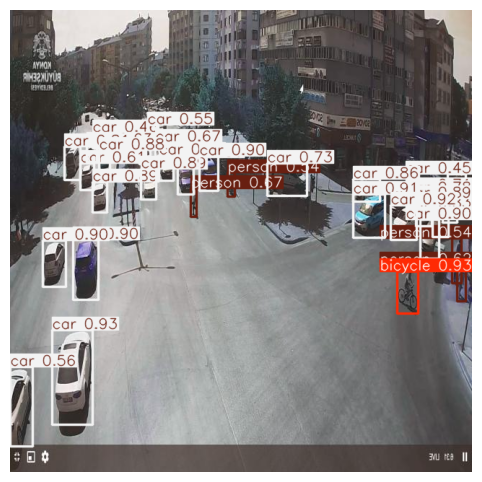


image 1/1 /kaggle/input/traffic-detection-project/test/images/screenshot_14324_jpg.rf.e0e997784af6427e20d0136c75ff1b5a.jpg: 640x640 11 cars, 16 persons, 17.0ms
Speed: 3.0ms preprocess, 17.0ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


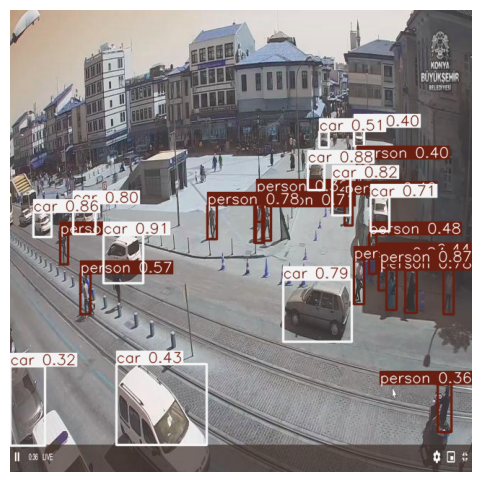


image 1/1 /kaggle/input/traffic-detection-project/test/images/aguanambi-2105_png_jpg.rf.913b43f78d50d1ac51dcf3e43cc7da2b.jpg: 640x640 18 cars, 3 motorbikes, 17.1ms
Speed: 3.0ms preprocess, 17.1ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


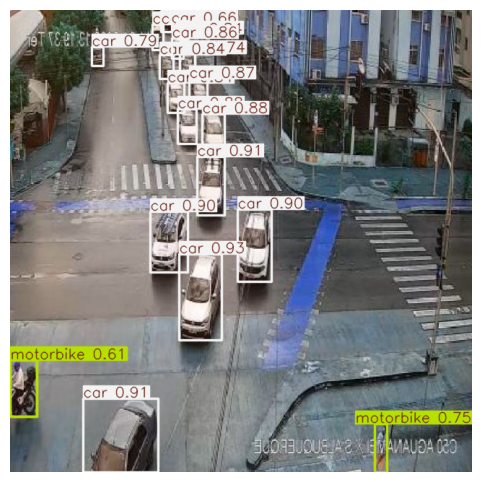


image 1/1 /kaggle/input/traffic-detection-project/test/images/image41_png_jpg.rf.0491e6f32304a84ab6c549ba311b268a.jpg: 640x640 2 bicycles, 15 cars, 6 persons, 17.2ms
Speed: 3.1ms preprocess, 17.2ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


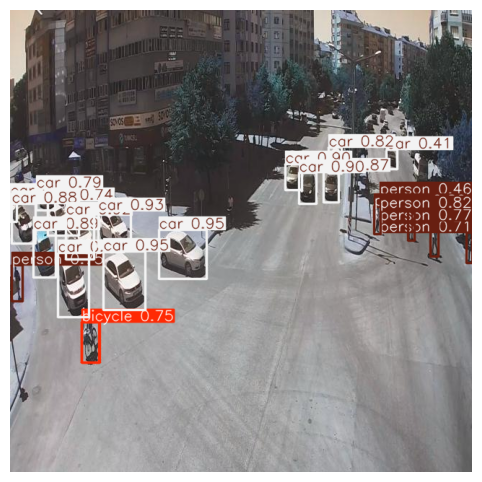


image 1/1 /kaggle/input/traffic-detection-project/test/images/image93_png_jpg.rf.db0e6e038d0f47fd708e5aca86dc3457.jpg: 640x640 6 cars, 17.0ms
Speed: 1.5ms preprocess, 17.0ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


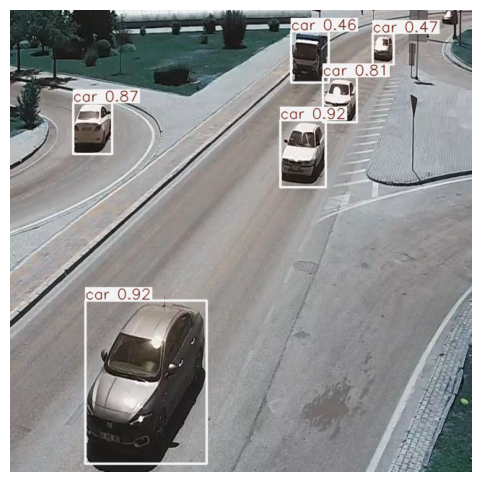


image 1/1 /kaggle/input/traffic-detection-project/test/images/duque_de_caxias-1605_png_jpg.rf.9ff453450e848625deb012bce5172451.jpg: 640x640 9 cars, 7 motorbikes, 17.1ms
Speed: 1.4ms preprocess, 17.1ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


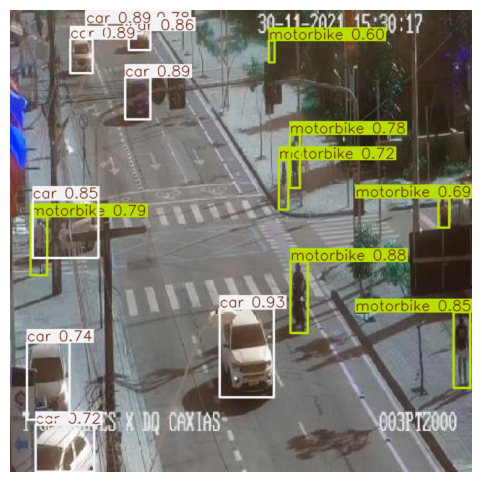


image 1/1 /kaggle/input/traffic-detection-project/test/images/ant_sales-10965_png_jpg.rf.bc89fbd399c8f3239dc7735f9bbca90c.jpg: 640x640 1 bicycle, 4 cars, 1 motorbike, 17.4ms
Speed: 1.6ms preprocess, 17.4ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


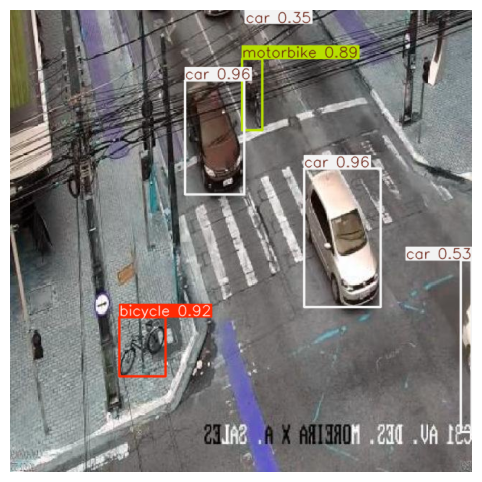


image 1/1 /kaggle/input/traffic-detection-project/test/images/image19_png_jpg.rf.198d9940a9c989685302cc7ef957f20f.jpg: 640x640 1 bus, 19 cars, 17.1ms
Speed: 1.9ms preprocess, 17.1ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


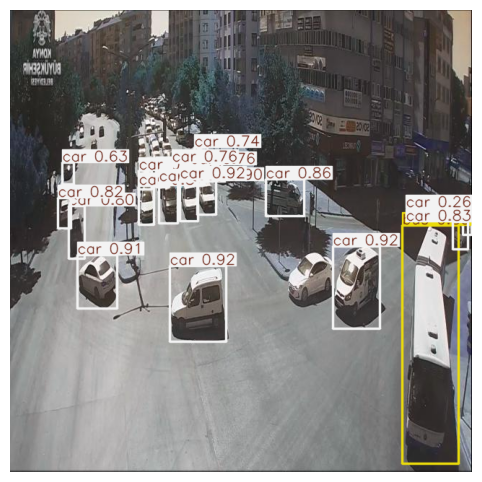


image 1/1 /kaggle/input/traffic-detection-project/test/images/image01_png_jpg.rf.439f3323af6b81619c993de762d69825.jpg: 640x640 1 bicycle, 6 cars, 1 motorbike, 18 persons, 17.0ms
Speed: 1.8ms preprocess, 17.0ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)


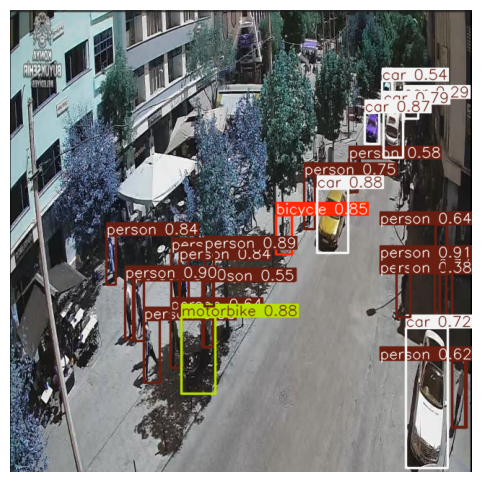


image 1/1 /kaggle/input/traffic-detection-project/test/images/screenshot_450_jpg.rf.661aa35ea660b7598f9b6ea7c26c93bc.jpg: 640x640 17 cars, 17.0ms
Speed: 1.5ms preprocess, 17.0ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


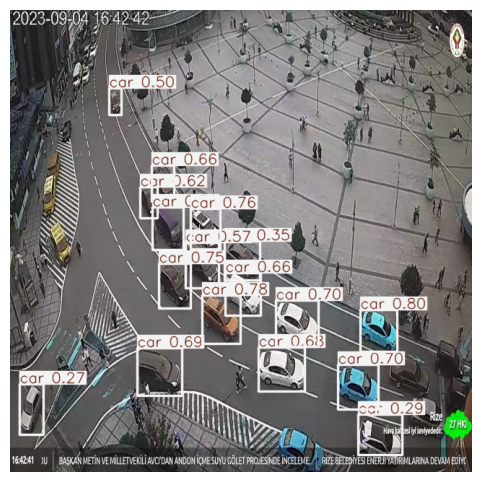


image 1/1 /kaggle/input/traffic-detection-project/test/images/aguanambi-4850_png_jpg.rf.465a57fdb61c7b46531176ad00381431.jpg: 640x640 13 cars, 6 motorbikes, 1 person, 17.0ms
Speed: 1.6ms preprocess, 17.0ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


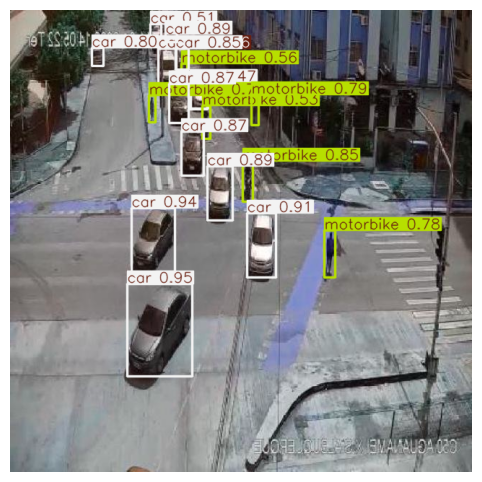


image 1/1 /kaggle/input/traffic-detection-project/test/images/image65_png_jpg.rf.4b59ec23626f2dc537b33c0e021070f3.jpg: 640x640 3 bicycles, 2 cars, 1 person, 17.1ms
Speed: 1.4ms preprocess, 17.1ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


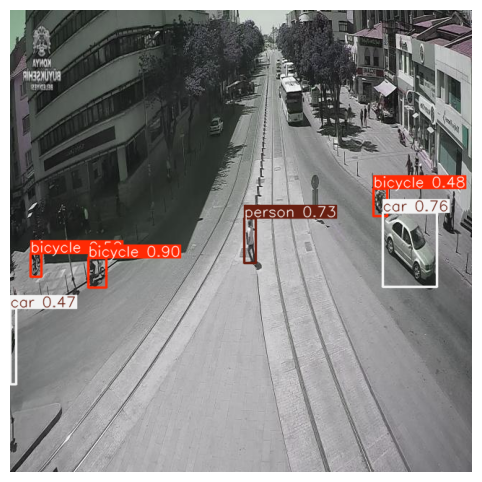


image 1/1 /kaggle/input/traffic-detection-project/test/images/screenshot_1639_jpg.rf.c81c55b50182804ce1aae0d254881e42.jpg: 640x640 20 cars, 7 persons, 17.1ms
Speed: 1.4ms preprocess, 17.1ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


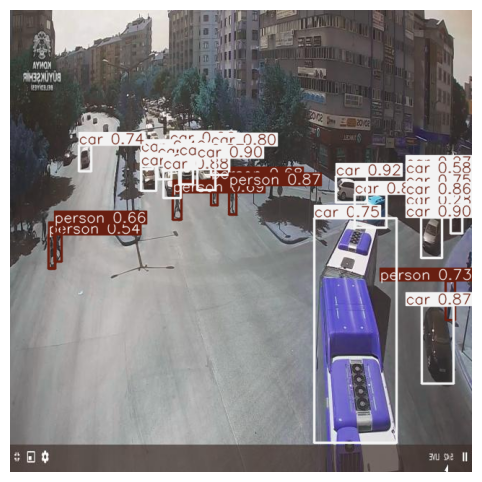


image 1/1 /kaggle/input/traffic-detection-project/test/images/aguanambi-4980_png_jpg.rf.12a1415ecb01eb7dc9e3045f0ff5a669.jpg: 640x640 17 cars, 5 motorbikes, 17.0ms
Speed: 1.5ms preprocess, 17.0ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


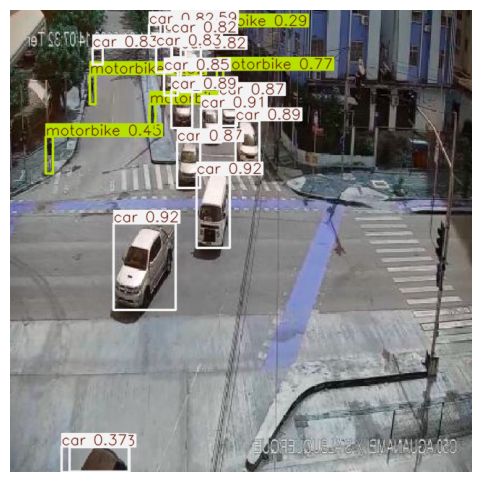


image 1/1 /kaggle/input/traffic-detection-project/test/images/screenshot_12524_jpg.rf.a0007d904098f23ee626c345105ebd30.jpg: 640x640 1 car, 1 person, 17.0ms
Speed: 1.6ms preprocess, 17.0ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


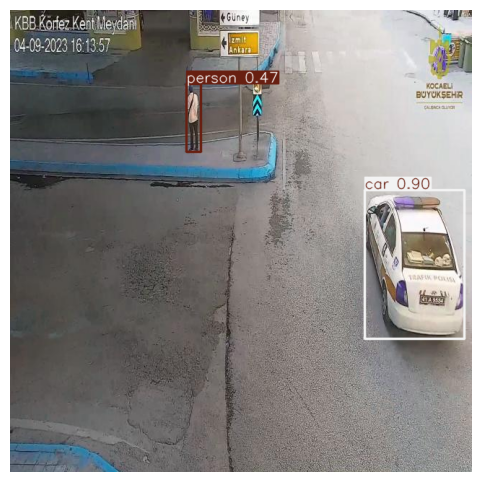


image 1/1 /kaggle/input/traffic-detection-project/test/images/ant_sales-1840_png_jpg.rf.fa532123d73379d06cf136371e5f2a70.jpg: 640x640 3 cars, 2 motorbikes, 17.0ms
Speed: 1.5ms preprocess, 17.0ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


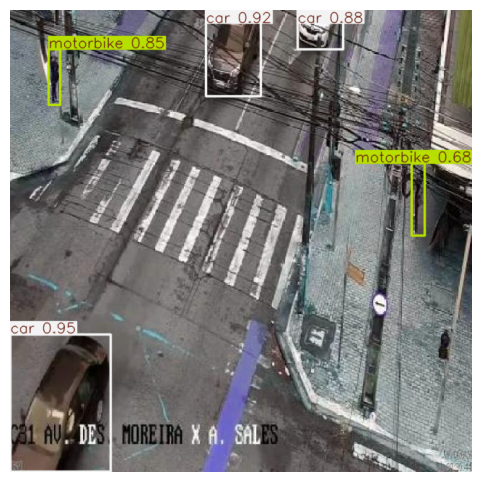


image 1/1 /kaggle/input/traffic-detection-project/test/images/ant_sales-12120_png_jpg.rf.3a951040438d33746bfafa0721a88e28.jpg: 640x640 1 bicycle, 3 cars, 2 motorbikes, 17.0ms
Speed: 1.5ms preprocess, 17.0ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)


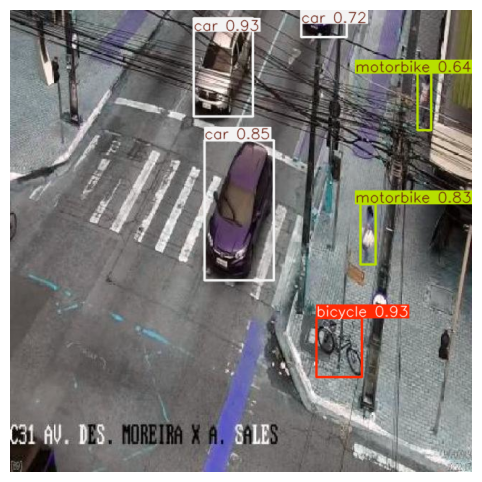


image 1/1 /kaggle/input/traffic-detection-project/test/images/aguanambi-3415_png_jpg.rf.27d07c6cc10c50b17db86bb3cf862508.jpg: 640x640 2 bicycles, 15 cars, 8 motorbikes, 17.1ms
Speed: 1.5ms preprocess, 17.1ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


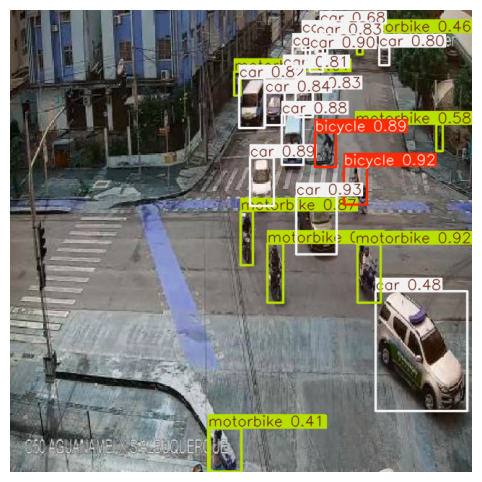


image 1/1 /kaggle/input/traffic-detection-project/test/images/screenshot_38159_jpg.rf.1ed1c7b8245c077884b38e6dc316ddd9.jpg: 640x640 5 cars, 17.1ms
Speed: 1.5ms preprocess, 17.1ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


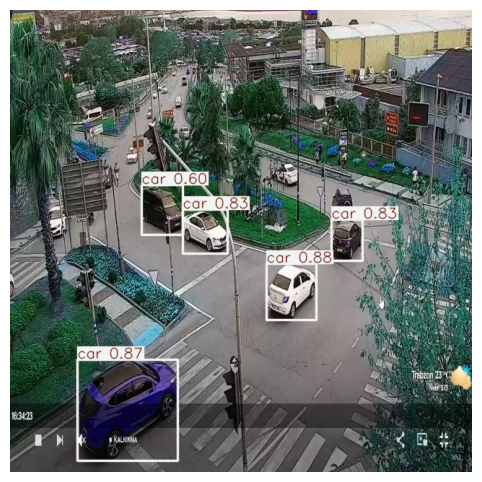


image 1/1 /kaggle/input/traffic-detection-project/test/images/duque_de_caxias-2180_png_jpg.rf.98cec5b97edb21562b08cb0f7754bb9c.jpg: 640x640 8 cars, 7 motorbikes, 17.0ms
Speed: 1.5ms preprocess, 17.0ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)


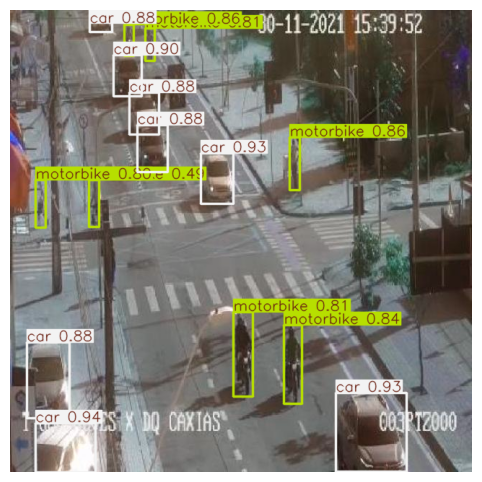


image 1/1 /kaggle/input/traffic-detection-project/test/images/duque_de_caxias-1140_png_jpg.rf.548bee19233d1dc5b1d099ce20ac6487.jpg: 640x640 1 bicycle, 10 cars, 10 motorbikes, 17.0ms
Speed: 1.4ms preprocess, 17.0ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)


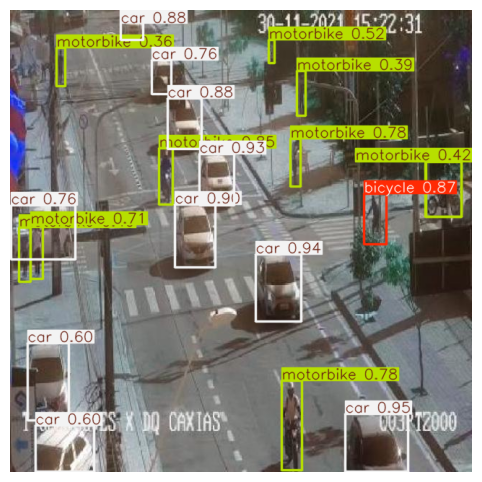


image 1/1 /kaggle/input/traffic-detection-project/test/images/ant_sales-11580_png_jpg.rf.f64b09fd14e67b556e202cb8efa5a664.jpg: 640x640 1 bicycle, 2 cars, 3 motorbikes, 17.0ms
Speed: 1.5ms preprocess, 17.0ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


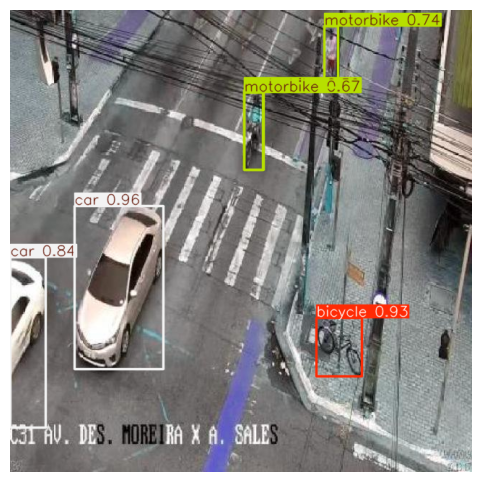


image 1/1 /kaggle/input/traffic-detection-project/test/images/aguanambi-5425_png_jpg.rf.14d5886ee52334426d7f89d58c2de516.jpg: 640x640 12 cars, 5 motorbikes, 1 person, 17.0ms
Speed: 1.4ms preprocess, 17.0ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


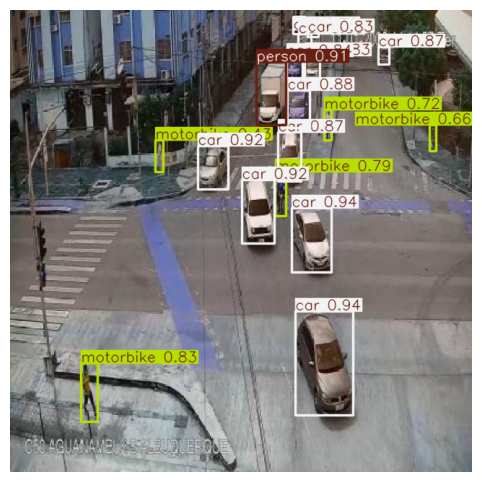


image 1/1 /kaggle/input/traffic-detection-project/test/images/screenshot_8496_jpg.rf.1ce57a07fd67e9bc7e884d184f9b55d9.jpg: 640x640 2 cars, 17.0ms
Speed: 1.4ms preprocess, 17.0ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


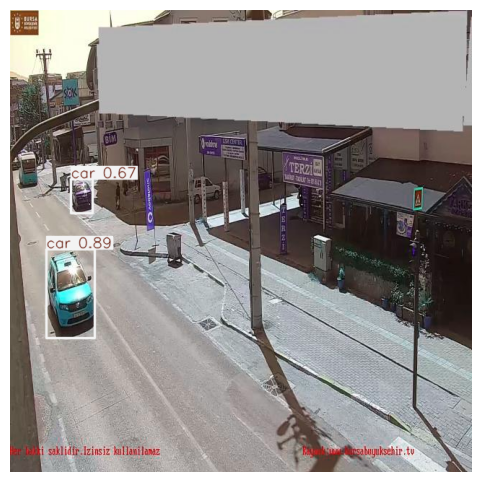


image 1/1 /kaggle/input/traffic-detection-project/test/images/ant_sales-11410_png_jpg.rf.9b840a5494e2a57a135b6eaf17df1b87.jpg: 640x640 3 bicycles, 4 cars, 1 motorbike, 17.0ms
Speed: 1.4ms preprocess, 17.0ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)


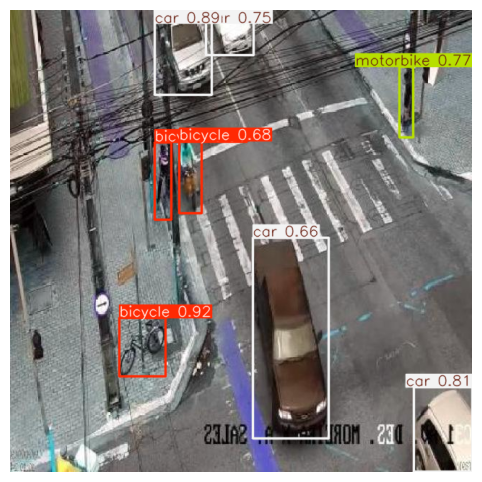


image 1/1 /kaggle/input/traffic-detection-project/test/images/aguanambi-4120_png_jpg.rf.d4fd0b97f992f9de887c70a97dad5d8f.jpg: 640x640 15 cars, 6 motorbikes, 17.0ms
Speed: 1.5ms preprocess, 17.0ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


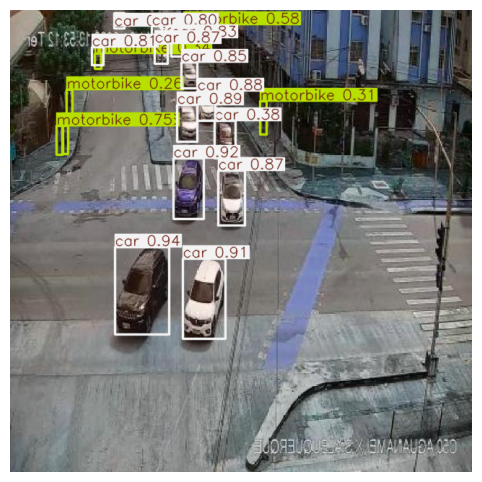


image 1/1 /kaggle/input/traffic-detection-project/test/images/image78_png_jpg.rf.f2fb0b7e3afba581e4c44b8a38708b29.jpg: 640x640 1 bicycle, 4 cars, 1 person, 17.0ms
Speed: 1.4ms preprocess, 17.0ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


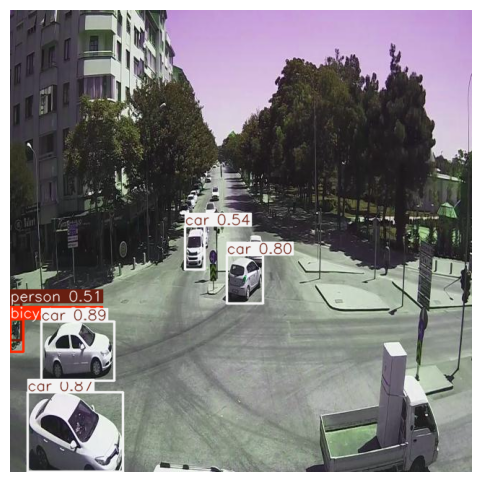


image 1/1 /kaggle/input/traffic-detection-project/test/images/aguanambi-1540_png_jpg.rf.b8ea6dd9130d82a3b6163bc3aaa823d3.jpg: 640x640 13 cars, 1 motorbike, 17.0ms
Speed: 1.5ms preprocess, 17.0ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


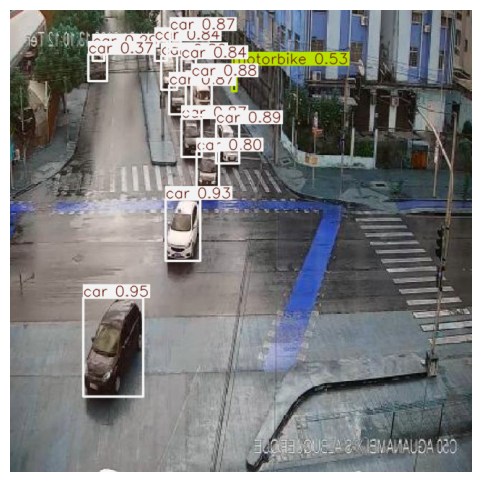


image 1/1 /kaggle/input/traffic-detection-project/test/images/image64_png_jpg.rf.d6a51ccd625b5b83f02af040108aa0bb.jpg: 640x640 4 persons, 17.0ms
Speed: 1.4ms preprocess, 17.0ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


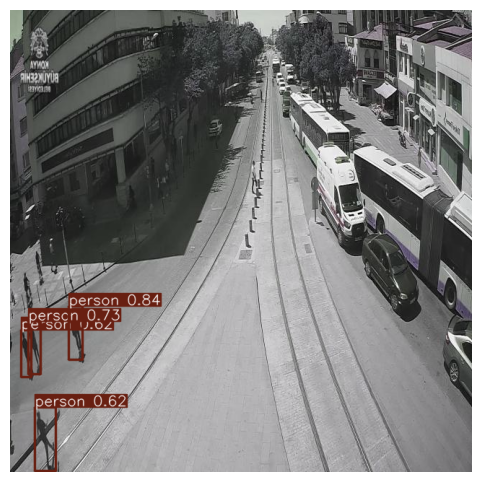


image 1/1 /kaggle/input/traffic-detection-project/test/images/duque_de_caxias-2325_png_jpg.rf.55c9fd8d13614e9acc273d62fca6a991.jpg: 640x640 7 cars, 3 motorbikes, 17.2ms
Speed: 2.4ms preprocess, 17.2ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


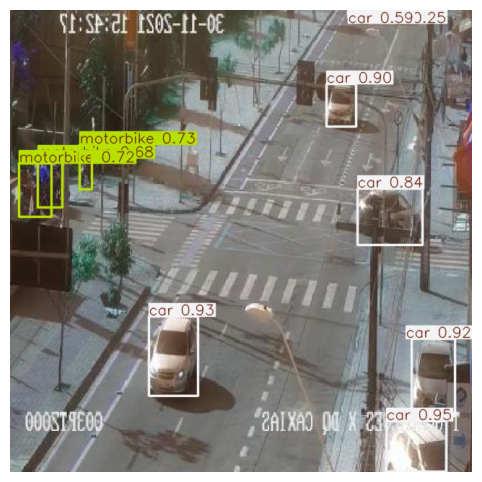


image 1/1 /kaggle/input/traffic-detection-project/test/images/aguanambi-4255_png_jpg.rf.1aaeafcaa45d001401fd35bb2c7788ea.jpg: 640x640 17 cars, 4 motorbikes, 17.0ms
Speed: 1.4ms preprocess, 17.0ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


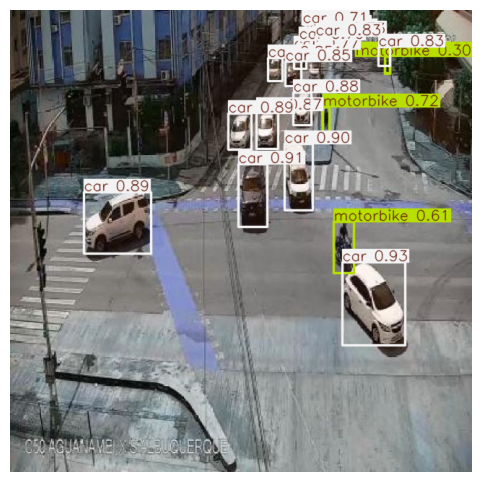


image 1/1 /kaggle/input/traffic-detection-project/test/images/duque_de_caxias-1910_png_jpg.rf.13b8cbe1338d78ba5b13767a834c441c.jpg: 640x640 4 cars, 9 motorbikes, 17.0ms
Speed: 1.4ms preprocess, 17.0ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)


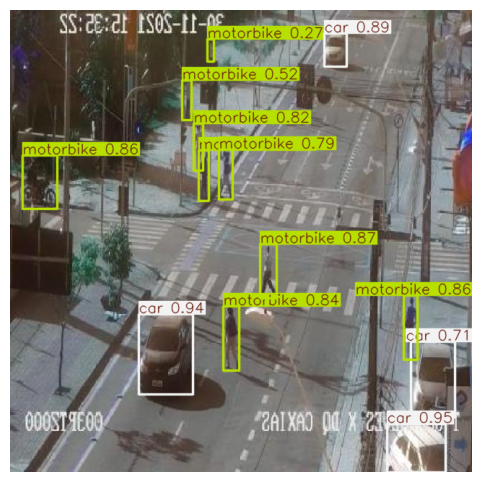


image 1/1 /kaggle/input/traffic-detection-project/test/images/screenshot_29811_jpg.rf.437232d7f824cf21338405e5a5b4284b.jpg: 640x640 2 persons, 17.1ms
Speed: 1.5ms preprocess, 17.1ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


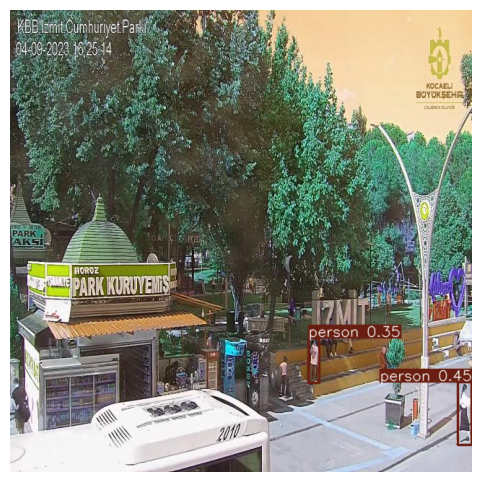


image 1/1 /kaggle/input/traffic-detection-project/test/images/image47_png_jpg.rf.75720d667f1a1ad75ff23f31a5e6436b.jpg: 640x640 1 bicycle, 12 cars, 9 persons, 17.1ms
Speed: 1.5ms preprocess, 17.1ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


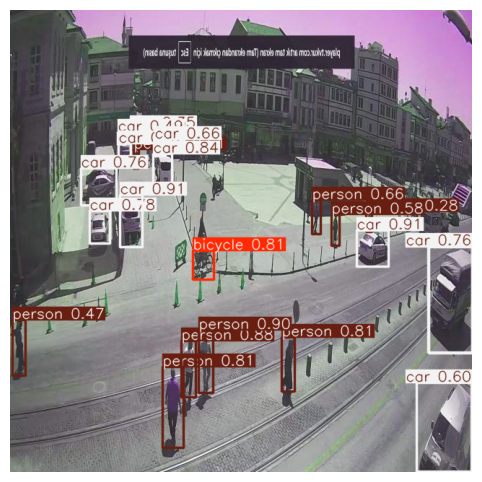


image 1/1 /kaggle/input/traffic-detection-project/test/images/duque_de_caxias-2300_png_jpg.rf.f4138ffc186611f0075c32d24129f7de.jpg: 640x640 1 bus, 11 cars, 3 motorbikes, 1 person, 17.0ms
Speed: 1.5ms preprocess, 17.0ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


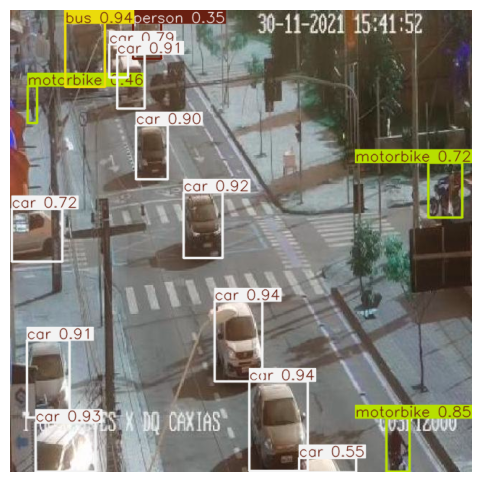


image 1/1 /kaggle/input/traffic-detection-project/test/images/aguanambi-3840_png_jpg.rf.e81264f835d8c15a3d578aa0554a9975.jpg: 640x640 1 bicycle, 17 cars, 8 motorbikes, 17.0ms
Speed: 1.5ms preprocess, 17.0ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)


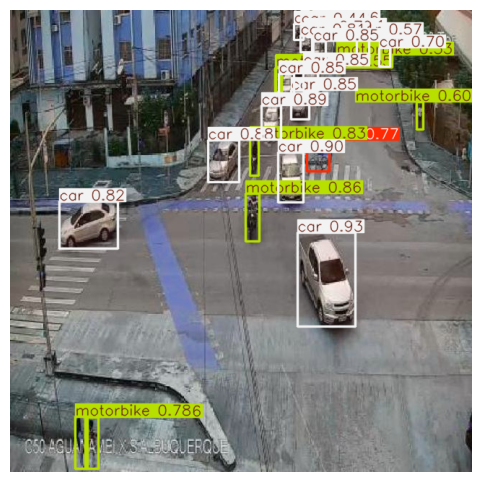


image 1/1 /kaggle/input/traffic-detection-project/test/images/image92_png_jpg.rf.9dc255607ab316d0a1be7d7d244ef073.jpg: 640x640 2 cars, 7 persons, 17.1ms
Speed: 1.5ms preprocess, 17.1ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


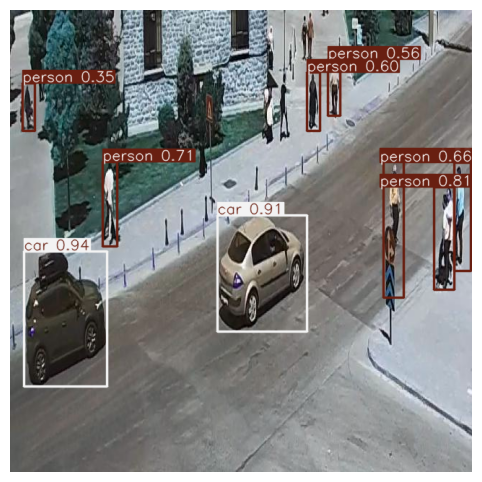


image 1/1 /kaggle/input/traffic-detection-project/test/images/duque_de_caxias-1300_png_jpg.rf.bedb30f8d1e8eab461acf70aa4cf9907.jpg: 640x640 2 buss, 7 cars, 7 motorbikes, 17.0ms
Speed: 1.4ms preprocess, 17.0ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


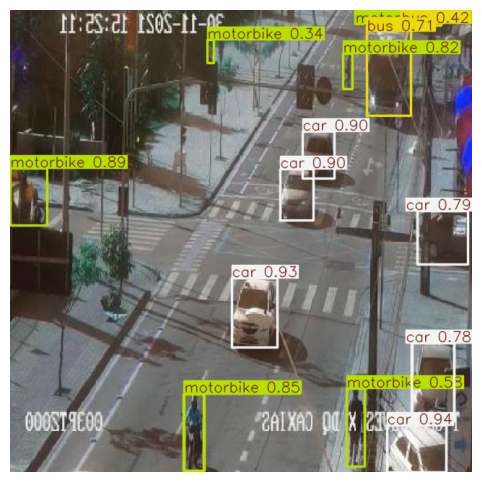


image 1/1 /kaggle/input/traffic-detection-project/test/images/image07_png_jpg.rf.337fd5d7f0c03747972168aeb8f286a9.jpg: 640x640 27 cars, 3 persons, 17.0ms
Speed: 1.4ms preprocess, 17.0ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)


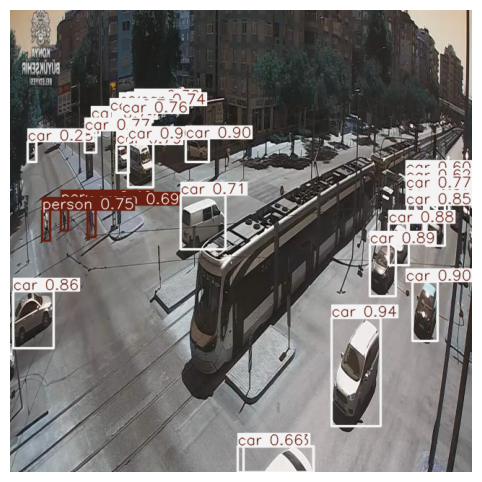


image 1/1 /kaggle/input/traffic-detection-project/test/images/image68_png_jpg.rf.44e19a08eb08ad8b35863b46f74a4a30.jpg: 640x640 (no detections), 17.1ms
Speed: 1.4ms preprocess, 17.1ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)


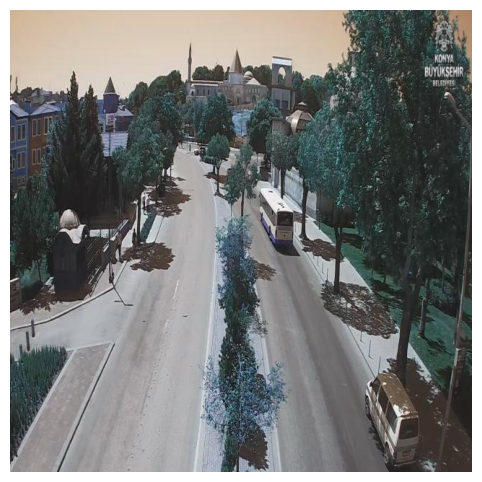


image 1/1 /kaggle/input/traffic-detection-project/test/images/ant_sales-11740_png_jpg.rf.4d7c76301215a7b5e8946757a22f6696.jpg: 640x640 1 bicycle, 2 cars, 3 motorbikes, 17.0ms
Speed: 1.5ms preprocess, 17.0ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)


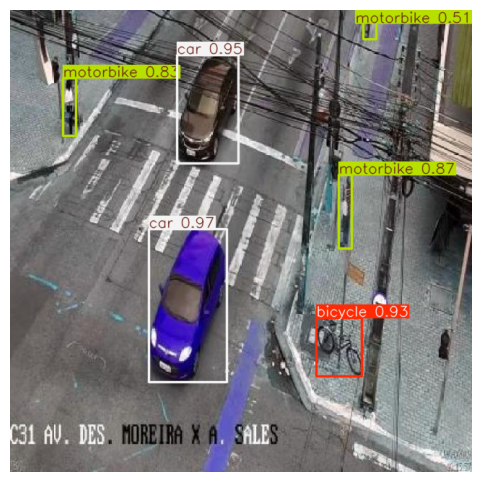


image 1/1 /kaggle/input/traffic-detection-project/test/images/image11_png_jpg.rf.fc3552ed0b2472b3cf27532253bcb974.jpg: 640x640 35 cars, 5 persons, 17.0ms
Speed: 1.5ms preprocess, 17.0ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


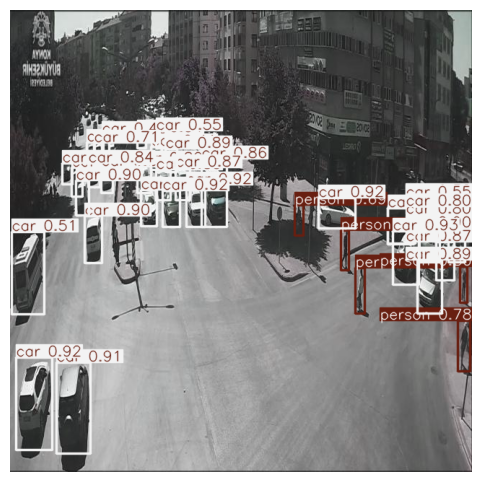


image 1/1 /kaggle/input/traffic-detection-project/test/images/duque_de_caxias-1035_png_jpg.rf.313fa2718fd690c3fc1c7df404e37dda.jpg: 640x640 1 bicycle, 6 cars, 6 motorbikes, 18.3ms
Speed: 2.3ms preprocess, 18.3ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)


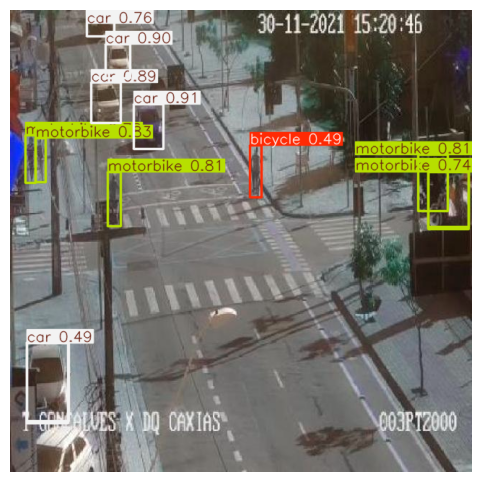


image 1/1 /kaggle/input/traffic-detection-project/test/images/aguanambi-5145_png_jpg.rf.3f1acd9087fddc94ce2b2c298cb60040.jpg: 640x640 1 bus, 13 cars, 3 motorbikes, 17.0ms
Speed: 1.4ms preprocess, 17.0ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


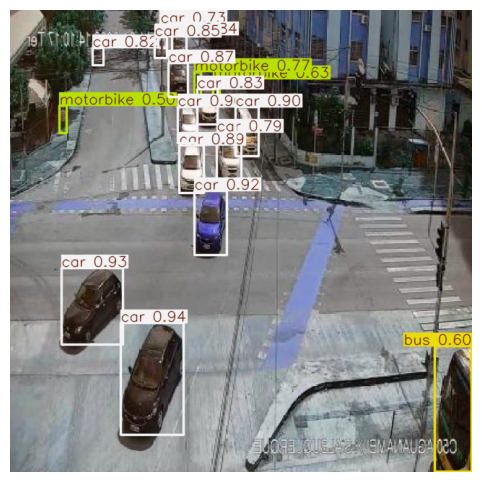


image 1/1 /kaggle/input/traffic-detection-project/test/images/image44_png_jpg.rf.2123dd144606f16b090ccf6c7d4640bf.jpg: 640x640 2 bicycles, 8 cars, 7 persons, 17.0ms
Speed: 1.4ms preprocess, 17.0ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


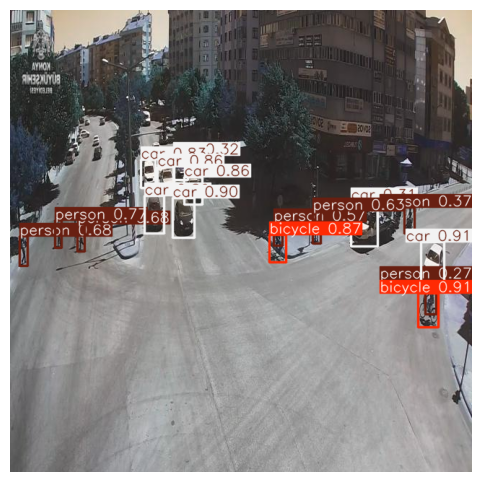

In [ ]:
#visualiser les resultats de prédiction de plusieurs images
image_dir = "/kaggle/input/traffic-detection-project/test/images"

all_images = os.listdir(image_dir)
selected_images = all_images[:45]

for img_name in selected_images:
    img_path = os.path.join(image_dir, img_name)
    results = model.predict(img_path)
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    for result in results:
        plotted_img = result.plot()
        plt.figure(figsize=(8, 6))
        plt.imshow(plotted_img)
        plt.axis('off')
        plt.show()
